In [138]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
df = pd.read_csv("AB_NYC_2019.csv")
df2 = pd.read_csv("AB_NYC_2019.csv")

In [2]:
# looking into the dataset to see how the data looks like
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
#looking at the shape to figure out the size we are working with
df.shape

(48895, 16)

In [4]:
# checking to see how many null values there are per column
df.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

In [5]:
#dropping columns that are not significant to our project
df.drop(['host_name','id','last_review'], axis=1, inplace=True)

df.head(10)

,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
2,THE VILLAGE OF HARLEM....NEW YORK !,4632,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,1,365
3,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,Entire Apt: Spacious Studio/Loft by central park,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0
5,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129
6,BlissArtsSpace!,7356,Brooklyn,Bedford-Stuyvesant,40.68688,-73.95596,Private room,60,45,49,0.40,1,0
7,Large Furnished Room Near B'way,8967,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,3.47,1,220
8,Cozy Clean Guest Room - Family Apt,7490,Manhattan,Upper West Side,40.80178,-73.96723,Private room,79,2,118,0.99,1,0
9,Cute & Cozy Lower East Side 1 bdrm,7549,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,1.33,4,188


In [6]:
# For the reviews per month, I will filling in the NA values with zeros, since there was no reviews for that month
df.fillna({'reviews_per_month': 0}, inplace = True)
df['reviews_per_month'].isnull().sum()

0

In [149]:
# printing out the datatypes of each column to find that there are mostly numberical values
print(df.dtypes)

only_num = pd.DataFrame(df.loc[:, ~df.columns.isin(['name', 'host_name', 'neighbourhood_group', 'neighbourhood', 'reviews_per_month', 'room_type', 'last_review'])])

id                                  int64
name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object


In [150]:

print(only_num)

             id   host_id  latitude  longitude  price  minimum_nights  \
0          2539      2787  40.64749  -73.97237    149               1   
1          2595      2845  40.75362  -73.98377    225               1   
2          3647      4632  40.80902  -73.94190    150               3   
3          3831      4869  40.68514  -73.95976     89               1   
4          5022      7192  40.79851  -73.94399     80              10   
...         ...       ...       ...        ...    ...             ...   
48890  36484665   8232441  40.67853  -73.94995     70               2   
48891  36485057   6570630  40.70184  -73.93317     40               4   
48892  36485431  23492952  40.81475  -73.94867    115              10   
48893  36485609  30985759  40.75751  -73.99112     55               1   
48894  36487245  68119814  40.76404  -73.98933     90               7   

       number_of_reviews  calculated_host_listings_count  availability_365  
0                      9                      

In [8]:
# I also like after cleaning the data call the .describe function to paint a better picture into what I am looking at/for
df.describe()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000
mean,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.090910,7.143982,112.781327
std,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.597283,32.952519,131.622289
min,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.040000,1.000000,0.000000
50%,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.370000,1.000000,45.000000
75%,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,1.580000,2.000000,227.000000
max,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [16]:
# finding out the unique values in the neighbourhood group column
df.neighbourhood_group.unique()

array(['Brooklyn', 'Manhattan', 'Queens', 'Staten Island', 'Bronx'],
      dtype=object)

In [11]:
# doing the same thing of looking at unique 
len(df.neighbourhood.unique())

221

In [12]:
df.neighbourhood_group.value_counts()
#Since the most of the AirBnB's in this dataset is either in Manhatten or Broooklyn, we will only be looking at these 2 for now. Also where most tourist visit.

Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: neighbourhood_group, dtype: int64

In [54]:
#Getting the top 10 host_id with the most listings for Air BnB
top_10_host = pd.DataFrame(df.host_id.value_counts().head(10))
top_10_host.reset_index(inplace=True)
top_10_host.rename(columns={'index':'Host_id', 'host_id':'Host_Count'}, inplace=True)
top_host = top_10_host.max().Host_id
print(top_10_host)

     Host_id  Host_Count
0  219517861         327
1  107434423         232
2   30283594         121
3  137358866         103
4   16098958          96
5   12243051          96
6   61391963          91
7   22541573          87
8  200380610          65
9    7503643          52


[Text(0, 0, '219517861'),
 Text(1, 0, '107434423'),
 Text(2, 0, '30283594'),
 Text(3, 0, '137358866'),
 Text(4, 0, '16098958'),
 Text(5, 0, '12243051'),
 Text(6, 0, '61391963'),
 Text(7, 0, '22541573'),
 Text(8, 0, '200380610'),
 Text(9, 0, '7503643')]

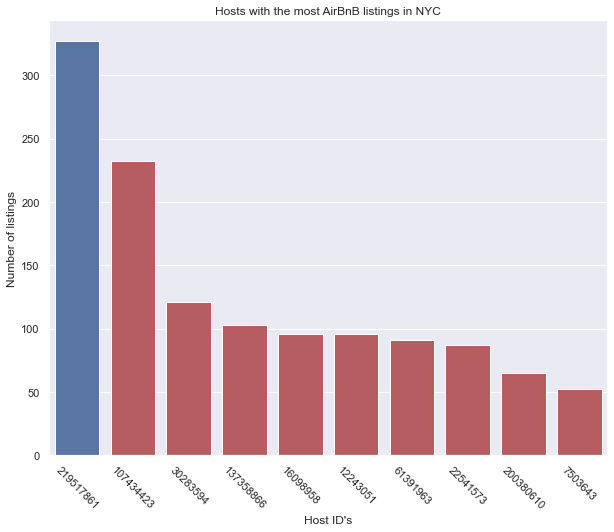

In [60]:
import seaborn as sns
#starting to visualize the findings of top hosts by plotting with a barplot with seaborn package
sns.set(rc={'figure.figsize':(10,8)})
plot1 = sns.barplot(x="Host_id", y="Host_Count", data=top_10_host, order=top_10_host.sort_values('Host_Count', ascending=False).Host_id, palette=["r" if x!=top_host else 'b' for x in top_10_host.Host_id])
plot1.set_title('Hosts with the most AirBnB listings in NYC')
plot1.set_ylabel('Number of listings')
plot1.set_xlabel("Host ID's")
plot1.set_xticklabels(plot1.get_xticklabels(), rotation=-45)

In [166]:
# checking where the listings are for the top Airbnb host in New york
top_host_df = df[df['host_id'] == 219517861]
# print(top_host_df)
top_host_df.neighbourhood_group.value_counts()

Manhattan    327
Name: neighbourhood_group, dtype: int64

In [167]:
# Since all of their listings were in Manhattan, I found which neighbourhoods exactly
top_host_df.neighbourhood.value_counts()

Financial District    218
Murray Hill            50
Theater District       27
Hell's Kitchen         15
Chelsea                 7
Upper East Side         6
Midtown                 4
Name: neighbourhood, dtype: int64

In [172]:
# average price of the top host in the dataset
top_host_df.price.mean()

253.19571865443424

In [183]:
# With Manhattan being more expensive compared to the other groups, I wanted to find the host with the most listings in Brooklnd
brook_df.host_id.value_counts()
brook_host = brook_df[brook_df['host_id'] == 7503643]
brook_host.neighbourhood.value_counts()

Greenpoint    52
Name: neighbourhood, dtype: int64

In [184]:
# Comparing the average price of a listing to the top manhattan host, finding that brooklyn is about 80$ cheaper per night
brook_host.price.mean()

149.19230769230768

<AxesSubplot:xlabel='price', ylabel='number_of_reviews'>

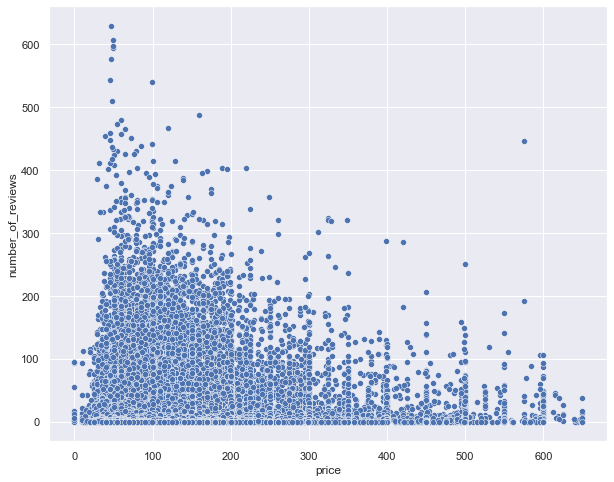

In [185]:
# plotting the price of listing compared to the number of reviews to possibly find a cooralation between the two
less_650 = df[df['price'] < 650]
sns.scatterplot(x=less_650.price, y=less_650.number_of_reviews)

In [103]:
# created a dataframe of each neigbourhood group
man_df = df[df['neighbourhood_group'] == 'Manhattan']
brook_df = df[df['neighbourhood_group'] == 'Brooklyn']
queens_df = df[df['neighbourhood_group'] == 'Queens']
bronx_df = df[df['neighbourhood_group'] == 'Bronx']
SI_df = df[df['neighbourhood_group'] == 'Staten Island']

[Text(0, 0, 'Manhattan'),
 Text(1, 0, 'Brooklyn'),
 Text(2, 0, 'Staten Island'),
 Text(3, 0, 'Queens'),
 Text(4, 0, 'Bronx')]

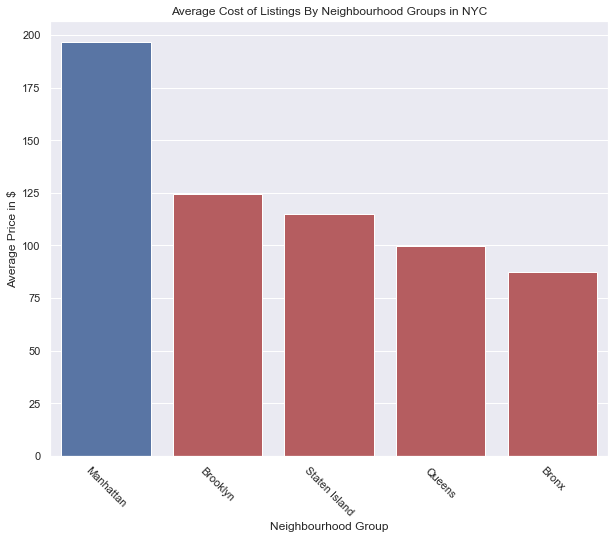

In [104]:
# creating variable of the average cost grouped by the neighbourhood group
avg_price = pd.DataFrame(df.groupby(['neighbourhood_group']).price.mean().sort_values(ascending=False))
avg_price.reset_index(inplace=True)
avg_price.rename(columns={'index':'neighbourhood_group', 'price':'Avg_Price'}, inplace=True)
# most_exp = avg_price.max().neighbourhood_group
plot2 = sns.barplot(x="neighbourhood_group", y="Avg_Price", data=avg_price, palette=["r" if x!='Manhattan' else 'b' for x in avg_price.neighbourhood_group])
plot2.set_title('Average Cost of Listings By Neighbourhood Groups in NYC')
plot2.set_ylabel('Average Price in $')
plot2.set_xlabel("Neighbourhood Group")
plot2.set_xticklabels(plot2.get_xticklabels(), rotation=-45)

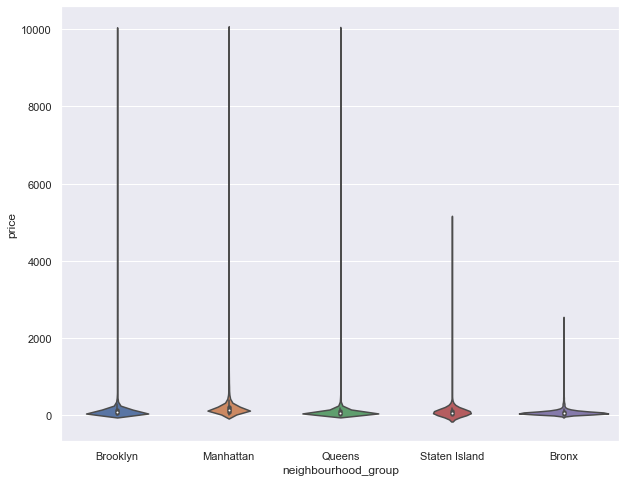

In [115]:
# plotting with a violinplot to see the distribution
plot3 = sns.violinplot(data=df, x='neighbourhood_group', y='price')

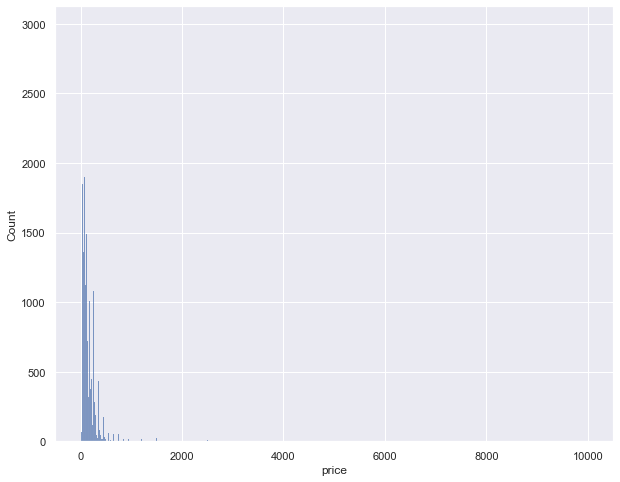

In [134]:
# after the graph above, I figured there was a huge price outlier, so I plotted a histogram to see
plt_hist = sns.histplot(data=df, x='price')

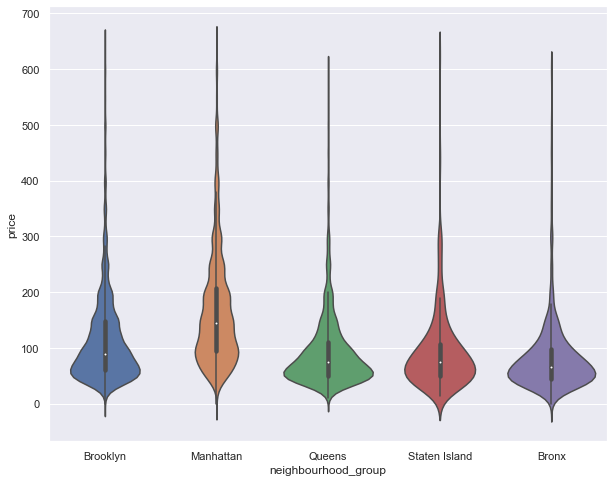

In [118]:
# Filtering out the major outliers and plotted the violin 
price_dit_subplot = df[df.price < 650]
plo4 = sns.violinplot(data=price_dit_subplot, x='neighbourhood_group', y='price')

[Text(0, 0, 'Tribeca'),
 Text(1, 0, 'Battery Park City'),
 Text(2, 0, 'Flatiron District'),
 Text(3, 0, 'NoHo'),
 Text(4, 0, 'SoHo'),
 Text(5, 0, 'Midtown'),
 Text(6, 0, 'West Village'),
 Text(7, 0, 'Greenwich Village'),
 Text(8, 0, 'Chelsea'),
 Text(9, 0, 'Theater District')]

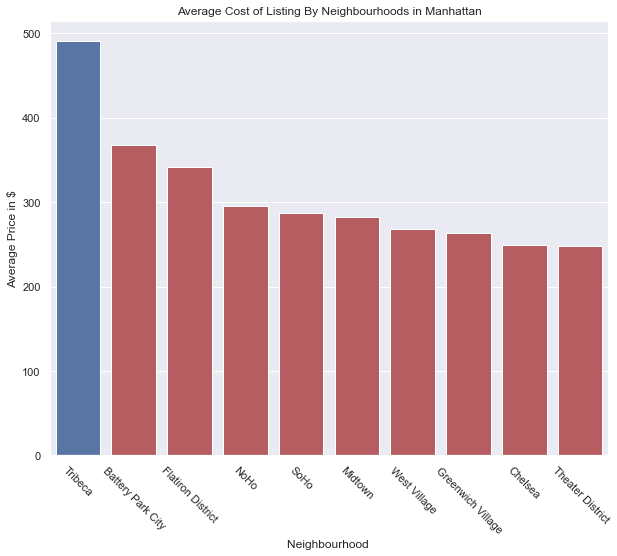

In [186]:
# average price of listings by neighbourhoods in Manhattan
avg_price_man = pd.DataFrame(man_df.groupby(['neighbourhood']).price.mean().sort_values(ascending=False).head(10))
avg_price_man.reset_index(inplace=True)
avg_price_man.rename(columns={'index':'neighbourhood', 'price':'Avg_Price'}, inplace=True)
plot5 = sns.barplot(x="neighbourhood", y="Avg_Price", data=avg_price_man, palette=["r" if x!='Tribeca' else 'b' for x in avg_price_man.neighbourhood])
plot5.set_title('Average Cost of Listing By Neighbourhoods in Manhattan')
plot5.set_ylabel('Average Price in $')
plot5.set_xlabel("Neighbourhood ")
plot5.set_xticklabels(plot5.get_xticklabels(), rotation=-45)

[Text(0, 0, 'Sea Gate'),
 Text(1, 0, 'Cobble Hill'),
 Text(2, 0, 'Brooklyn Heights'),
 Text(3, 0, 'DUMBO'),
 Text(4, 0, 'Vinegar Hill'),
 Text(5, 0, 'Clinton Hill'),
 Text(6, 0, 'Mill Basin'),
 Text(7, 0, 'Park Slope'),
 Text(8, 0, 'Boerum Hill'),
 Text(9, 0, 'Carroll Gardens')]

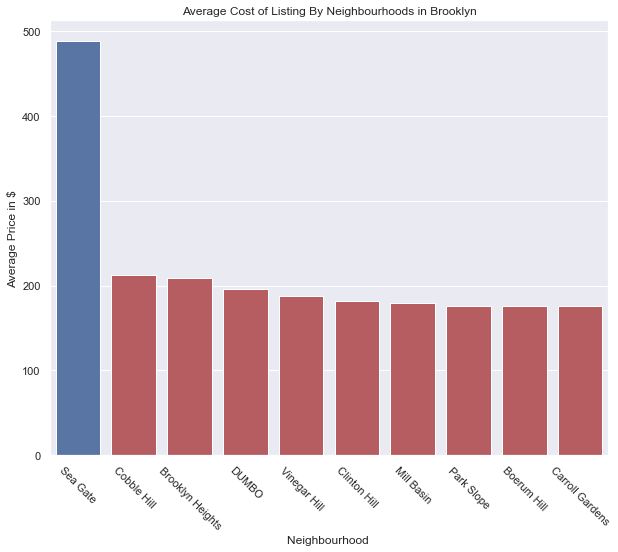

In [132]:
# graphing the average price of listings in Brooklyn neighbourhoods
avg_price_brook = pd.DataFrame(brook_df.groupby(['neighbourhood']).price.mean().sort_values(ascending=False).head(10))
avg_price_brook.reset_index(inplace=True)
avg_price_brook.rename(columns={'index':'neighbourhood', 'price':'Avg_Price'}, inplace=True)
plot5 = sns.barplot(x="neighbourhood", y="Avg_Price", data=avg_price_brook, palette=["r" if x!='Sea Gate' else 'b' for x in avg_price_brook.neighbourhood])
plot5.set_title('Average Cost of Listing By Neighbourhoods in Brooklyn')
plot5.set_ylabel('Average Price in $')
plot5.set_xlabel("Neighbourhood ")
plot5.set_xticklabels(plot5.get_xticklabels(), rotation=-45)

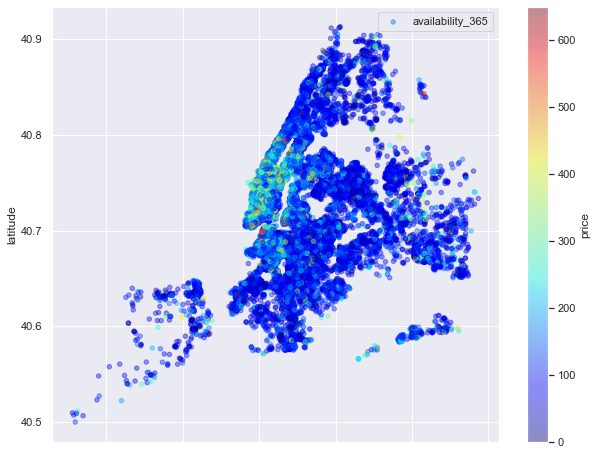

In [187]:
# I wanted to get a graph since the data included log and lat. So this is plotted but, I was unable to successfully 
regulated_price = df[df.price < 650]
map1 = regulated_price.plot(kind='scatter', x='longitude', y='latitude', label='availability_365', c='price',
                  cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4, figsize=(10,8))
map1.legend()

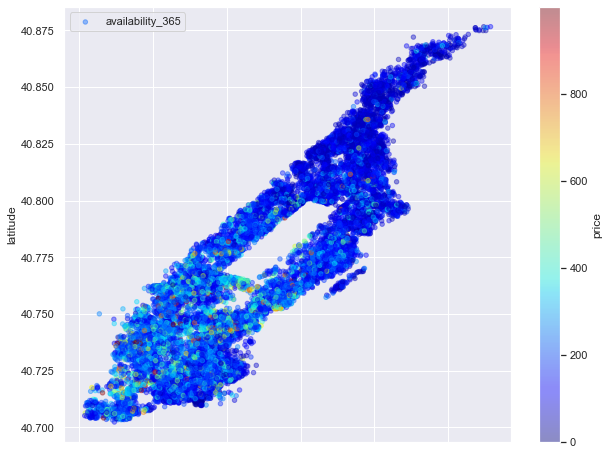

In [189]:
# plotting just the manhattan data points
map2=man_df[man_df.price<1000].plot(kind='scatter', x='longitude', y='latitude', label='availability_365', c='price',
                  cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4, figsize=(10,8))
map2.legend()

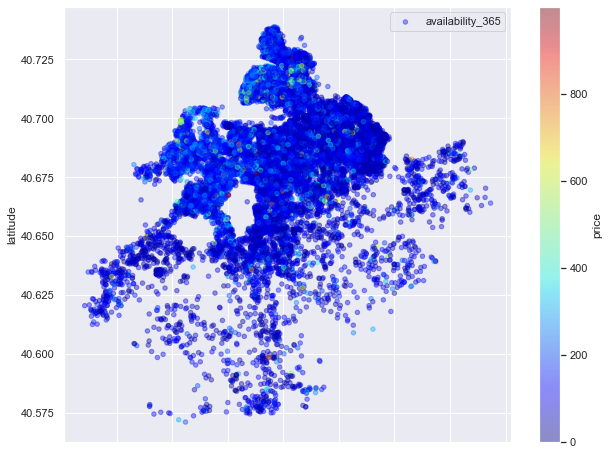

In [190]:
# plotting just the brooklyn data points
map3=brook_df[brook_df.price < 1000].plot(kind='scatter', x='longitude', y='latitude', label='availability_365', c='price',
                  cmap=plt.get_cmap('jet'), colorbar=True, alpha=0.4, figsize=(10,8))
map3.legend()

In [114]:
df['room_type'].value_counts()

Entire home/apt    25409
Private room       22326
Shared room         1160
Name: room_type, dtype: int64

In [113]:
avg_price_rt = pd.DataFrame(df.groupby(['room_type']).price.mean().sort_values(ascending=False))
avg_price_rt.reset_index(inplace=True)
avg_price_rt.rename(columns={'index':'room_type', 'price':'Avg_Price'}, inplace=True)
print(avg_price_rt)

         room_type   Avg_Price
0  Entire home/apt  211.794246
1     Private room   89.780973
2      Shared room   70.127586


For the sake of this project, I will only be focusing on the AirBnB in Manhattan and Brooklyn ares, since these are the most visited neighbourhoods in New York City.

In [20]:
#Top 5 neighbourhoods with the most Airbnb's in Manhatten
man_df.neighbourhood.value_counts().head(5)

Harlem             2658
Upper West Side    1971
Hell's Kitchen     1958
East Village       1853
Upper East Side    1798
Name: neighbourhood, dtype: int64

In [21]:
brook_df.neighbourhood.value_counts().head(5)

Williamsburg          3920
Bedford-Stuyvesant    3714
Bushwick              2465
Crown Heights         1564
Greenpoint            1115
Name: neighbourhood, dtype: int64